In [10]:
# LIBRAIRIES IMPORT
# Data
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans 

# Visualisation
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
import seaborn as sns
import folium
# Metrics
from sklearn import metrics

# Elbow
from yellowbrick.cluster import KElbowVisualizer

In [11]:
data = pd.read_csv(r"C:\Users\rana_\OneDrive\Bureau\Final project\data.csv")

In [12]:
data

,Unnamed: 0,Code du département,Libellé du département,Code de la circonscription,Code de la commune,Libellé de la commune,Inscrits,Abstentions,% Abs/Ins,Votants,...,% Exp/Ins,% Exp/Vot,Sexe,Voix,% Voix/Ins,% Voix/Exp,Code Officiel Région,Nom Officiel Région,location,Candidat
0,0,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,...,75.00,100.00,M,3,6.82,"9,09",44.0,Grand Est,"49.317453,5.647972",Éric ZEMMOUR
1,1,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,...,75.00,100.00,M,5,11.36,"15,15",44.0,Grand Est,"49.317453,5.647972",Jean-Luc MÉLENCHON
2,2,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,...,75.00,100.00,F,1,2.27,"3,03",44.0,Grand Est,"49.317453,5.647972",Valérie PÉCRESSE
3,3,55,Meuse,2,55545,Verdun,808,329,40.72,479,...,56.81,95.82,M,8,0.99,"1,74",44.0,Grand Est,"49.160479,5.378136",Philippe POUTOU
4,4,55,Meuse,2,55545,Verdun,1318,499,37.86,819,...,60.70,97.68,M,25,1.90,"3,13",44.0,Grand Est,"49.150832,5.400586",Fabien ROUSSEL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
724003,836263,62,Pas-de-Calais,1,62796,Simencourt,459,78,16.99,381,...,81.05,97.64,F,7,1.53,"1,88",32.0,Hauts-de-France,"50.258141,2.643003",Anne HIDALGO
724004,836264,62,Pas-de-Calais,2,62801,Souchez,1205,299,24.81,906,...,74.27,98.79,F,25,2.07,"2,79",32.0,Hauts-de-France,"50.391562,2.742967",Anne HIDALGO
724005,836265,62,Pas-de-Calais,6,62803,Surques,440,75,17.05,365,...,80.68,97.26,M,13,2.95,"3,66",32.0,Hauts-de-France,"50.742017,1.919849",Jean LASSALLE
724006,836266,62,Pas-de-Calais,6,62803,Surques,440,75,17.05,365,...,80.68,97.26,M,9,2.05,"2,54",32.0,Hauts-de-France,"50.742017,1.919849",Nicolas DUPONT-AIGNAN


In [13]:
data.drop(['Unnamed: 0'], axis = 1, inplace=True)
data

,Code du département,Libellé du département,Code de la circonscription,Code de la commune,Libellé de la commune,Inscrits,Abstentions,% Abs/Ins,Votants,% Vot/Ins,...,% Exp/Ins,% Exp/Vot,Sexe,Voix,% Voix/Ins,% Voix/Exp,Code Officiel Région,Nom Officiel Région,location,Candidat
0,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,75.00,...,75.00,100.00,M,3,6.82,"9,09",44.0,Grand Est,"49.317453,5.647972",Éric ZEMMOUR
1,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,75.00,...,75.00,100.00,M,5,11.36,"15,15",44.0,Grand Est,"49.317453,5.647972",Jean-Luc MÉLENCHON
2,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,75.00,...,75.00,100.00,F,1,2.27,"3,03",44.0,Grand Est,"49.317453,5.647972",Valérie PÉCRESSE
3,55,Meuse,2,55545,Verdun,808,329,40.72,479,59.28,...,56.81,95.82,M,8,0.99,"1,74",44.0,Grand Est,"49.160479,5.378136",Philippe POUTOU
4,55,Meuse,2,55545,Verdun,1318,499,37.86,819,62.14,...,60.70,97.68,M,25,1.90,"3,13",44.0,Grand Est,"49.150832,5.400586",Fabien ROUSSEL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
724003,62,Pas-de-Calais,1,62796,Simencourt,459,78,16.99,381,83.01,...,81.05,97.64,F,7,1.53,"1,88",32.0,Hauts-de-France,"50.258141,2.643003",Anne HIDALGO
724004,62,Pas-de-Calais,2,62801,Souchez,1205,299,24.81,906,75.19,...,74.27,98.79,F,25,2.07,"2,79",32.0,Hauts-de-France,"50.391562,2.742967",Anne HIDALGO
724005,62,Pas-de-Calais,6,62803,Surques,440,75,17.05,365,82.95,...,80.68,97.26,M,13,2.95,"3,66",32.0,Hauts-de-France,"50.742017,1.919849",Jean LASSALLE
724006,62,Pas-de-Calais,6,62803,Surques,440,75,17.05,365,82.95,...,80.68,97.26,M,9,2.05,"2,54",32.0,Hauts-de-France,"50.742017,1.919849",Nicolas DUPONT-AIGNAN


In [14]:
data.dtypes

Code du département             int64
Libellé du département         object
Code de la circonscription      int64
Code de la commune              int64
Libellé de la commune          object
Inscrits                        int64
Abstentions                     int64
% Abs/Ins                     float64
Votants                         int64
% Vot/Ins                     float64
Blancs                          int64
% Blancs/Ins                  float64
% Blancs/Vot                  float64
Nuls                            int64
% Nuls/Ins                    float64
% Nuls/Vot                    float64
Exprimés                        int64
% Exp/Ins                     float64
% Exp/Vot                     float64
Sexe                           object
Voix                            int64
% Voix/Ins                    float64
% Voix/Exp                     object
Code Officiel Région          float64
Nom Officiel Région            object
location                       object
Candidat    

In [15]:
data.columns = data.columns.str.strip()

In [18]:
data

,Code du département,Libellé du département,Code de la circonscription,Code de la commune,Libellé de la commune,Inscrits,Abstentions,% Abs/Ins,Votants,% Vot/Ins,...,% Exp/Ins,% Exp/Vot,Sexe,Voix,% Voix/Ins,% Voix/Exp,Code Officiel Région,Nom Officiel Région,location,Candidat
0,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,75.00,...,75.00,100.00,M,3,6.82,"9,09",44.0,Grand Est,"49.317453,5.647972",Éric ZEMMOUR
1,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,75.00,...,75.00,100.00,M,5,11.36,"15,15",44.0,Grand Est,"49.317453,5.647972",Jean-Luc MÉLENCHON
2,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,75.00,...,75.00,100.00,F,1,2.27,"3,03",44.0,Grand Est,"49.317453,5.647972",Valérie PÉCRESSE
3,55,Meuse,2,55545,Verdun,808,329,40.72,479,59.28,...,56.81,95.82,M,8,0.99,"1,74",44.0,Grand Est,"49.160479,5.378136",Philippe POUTOU
4,55,Meuse,2,55545,Verdun,1318,499,37.86,819,62.14,...,60.70,97.68,M,25,1.90,"3,13",44.0,Grand Est,"49.150832,5.400586",Fabien ROUSSEL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
724003,62,Pas-de-Calais,1,62796,Simencourt,459,78,16.99,381,83.01,...,81.05,97.64,F,7,1.53,"1,88",32.0,Hauts-de-France,"50.258141,2.643003",Anne HIDALGO
724004,62,Pas-de-Calais,2,62801,Souchez,1205,299,24.81,906,75.19,...,74.27,98.79,F,25,2.07,"2,79",32.0,Hauts-de-France,"50.391562,2.742967",Anne HIDALGO
724005,62,Pas-de-Calais,6,62803,Surques,440,75,17.05,365,82.95,...,80.68,97.26,M,13,2.95,"3,66",32.0,Hauts-de-France,"50.742017,1.919849",Jean LASSALLE
724006,62,Pas-de-Calais,6,62803,Surques,440,75,17.05,365,82.95,...,80.68,97.26,M,9,2.05,"2,54",32.0,Hauts-de-France,"50.742017,1.919849",Nicolas DUPONT-AIGNAN


In [19]:
from sklearn.preprocessing import LabelEncoder

#Encode labels


data['Name'] = data['Candidat']




,Code du département,Libellé du département,Code de la circonscription,Code de la commune,Libellé de la commune,Inscrits,Abstentions,% Abs/Ins,Votants,% Vot/Ins,...,% Exp/Vot,Sexe,Voix,% Voix/Ins,% Voix/Exp,Code Officiel Région,Nom Officiel Région,location,Candidat,Name
0,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,75.00,...,100.00,M,3,6.82,"9,09",44.0,Grand Est,"49.317453,5.647972",Éric ZEMMOUR,Éric ZEMMOUR
1,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,75.00,...,100.00,M,5,11.36,"15,15",44.0,Grand Est,"49.317453,5.647972",Jean-Luc MÉLENCHON,Jean-Luc MÉLENCHON
2,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,75.00,...,100.00,F,1,2.27,"3,03",44.0,Grand Est,"49.317453,5.647972",Valérie PÉCRESSE,Valérie PÉCRESSE
3,55,Meuse,2,55545,Verdun,808,329,40.72,479,59.28,...,95.82,M,8,0.99,"1,74",44.0,Grand Est,"49.160479,5.378136",Philippe POUTOU,Philippe POUTOU
4,55,Meuse,2,55545,Verdun,1318,499,37.86,819,62.14,...,97.68,M,25,1.90,"3,13",44.0,Grand Est,"49.150832,5.400586",Fabien ROUSSEL,Fabien ROUSSEL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
724003,62,Pas-de-Calais,1,62796,Simencourt,459,78,16.99,381,83.01,...,97.64,F,7,1.53,"1,88",32.0,Hauts-de-France,"50.258141,2.643003",Anne HIDALGO,Anne HIDALGO
724004,62,Pas-de-Calais,2,62801,Souchez,1205,299,24.81,906,75.19,...,98.79,F,25,2.07,"2,79",32.0,Hauts-de-France,"50.391562,2.742967",Anne HIDALGO,Anne HIDALGO
724005,62,Pas-de-Calais,6,62803,Surques,440,75,17.05,365,82.95,...,97.26,M,13,2.95,"3,66",32.0,Hauts-de-France,"50.742017,1.919849",Jean LASSALLE,Jean LASSALLE
724006,62,Pas-de-Calais,6,62803,Surques,440,75,17.05,365,82.95,...,97.26,M,9,2.05,"2,54",32.0,Hauts-de-France,"50.742017,1.919849",Nicolas DUPONT-AIGNAN,Nicolas DUPONT-AIGNAN


In [26]:
#renaming and recoding columns
from sklearn.preprocessing import OrdinalEncoder
encode=LabelEncoder()
data['code']=encode.fit_transform(data['Name'])

In [27]:
data

,Code du département,Libellé du département,Code de la circonscription,Code de la commune,Libellé de la commune,Inscrits,Abstentions,% Abs/Ins,Votants,% Vot/Ins,...,Sexe,Voix,% Voix/Ins,% Voix/Exp,Code Officiel Région,Nom Officiel Région,location,Candidat,Name,code
0,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,75.00,...,M,3,6.82,"9,09",44.0,Grand Est,"49.317453,5.647972",Éric ZEMMOUR,Éric ZEMMOUR,11
1,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,75.00,...,M,5,11.36,"15,15",44.0,Grand Est,"49.317453,5.647972",Jean-Luc MÉLENCHON,Jean-Luc MÉLENCHON,4
2,55,Meuse,2,55535,Vaudoncourt,44,11,25.00,33,75.00,...,F,1,2.27,"3,03",44.0,Grand Est,"49.317453,5.647972",Valérie PÉCRESSE,Valérie PÉCRESSE,9
3,55,Meuse,2,55545,Verdun,808,329,40.72,479,59.28,...,M,8,0.99,"1,74",44.0,Grand Est,"49.160479,5.378136",Philippe POUTOU,Philippe POUTOU,8
4,55,Meuse,2,55545,Verdun,1318,499,37.86,819,62.14,...,M,25,1.90,"3,13",44.0,Grand Est,"49.150832,5.400586",Fabien ROUSSEL,Fabien ROUSSEL,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
724003,62,Pas-de-Calais,1,62796,Simencourt,459,78,16.99,381,83.01,...,F,7,1.53,"1,88",32.0,Hauts-de-France,"50.258141,2.643003",Anne HIDALGO,Anne HIDALGO,0
724004,62,Pas-de-Calais,2,62801,Souchez,1205,299,24.81,906,75.19,...,F,25,2.07,"2,79",32.0,Hauts-de-France,"50.391562,2.742967",Anne HIDALGO,Anne HIDALGO,0
724005,62,Pas-de-Calais,6,62803,Surques,440,75,17.05,365,82.95,...,M,13,2.95,"3,66",32.0,Hauts-de-France,"50.742017,1.919849",Jean LASSALLE,Jean LASSALLE,3
724006,62,Pas-de-Calais,6,62803,Surques,440,75,17.05,365,82.95,...,M,9,2.05,"2,54",32.0,Hauts-de-France,"50.742017,1.919849",Nicolas DUPONT-AIGNAN,Nicolas DUPONT-AIGNAN,7


In [29]:
data[['latitude','longitude' ]] = data['location'].str.split(',', expand=True)

In [30]:
data.dtypes

Code du département             int64
Libellé du département         object
Code de la circonscription      int64
Code de la commune              int64
Libellé de la commune          object
Inscrits                        int64
Abstentions                     int64
% Abs/Ins                     float64
Votants                         int64
% Vot/Ins                     float64
Blancs                          int64
% Blancs/Ins                  float64
% Blancs/Vot                  float64
Nuls                            int64
% Nuls/Ins                    float64
% Nuls/Vot                    float64
Exprimés                        int64
% Exp/Ins                     float64
% Exp/Vot                     float64
Sexe                           object
Voix                            int64
% Voix/Ins                    float64
% Voix/Exp                     object
Code Officiel Région          float64
Nom Officiel Région            object
location                       object
Candidat    

In [31]:
data['latitude'] = pd.to_numeric(data['latitude'], errors='coerce')

In [32]:
data['longitude'] = pd.to_numeric(data['longitude'], errors='coerce')

In [34]:
data.drop(['Name'], axis=1, inplace=True)

In [35]:
data.rename(columns = {'code':'Name'}, inplace = True)

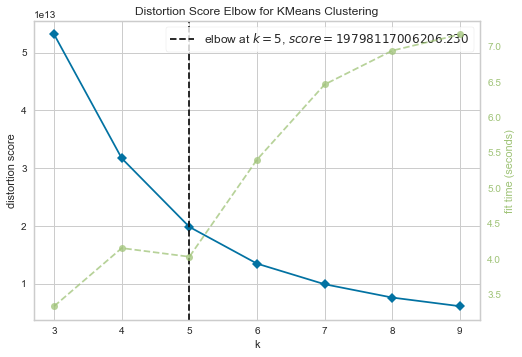

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [36]:
X = data[['Code du département', 'Code de la commune', 'Inscrits', 'Abstentions', 'Votants', 'Blancs', 'Nuls', 'Exprimés','Name','Voix', 'latitude', 'longitude']]
model = KMeans(random_state=42)
visualizer = KElbowVisualizer(estimator = model, k = (3,10))
visualizer.fit(X)
visualizer.poof()

In [9]:
# MODEL FITTING
model = KMeans(n_clusters=5, random_state=42 )
model.fit(X)



KMeans(n_clusters=5, random_state=42)

In [10]:
# MODEL PREDICTION
X_predict = X.copy()
X_predict['cluster'] = model.fit_predict(X)
X_predict.cluster.value_counts()

3    176076
4    172344
0    140628
2    119124
1    115836
Name: cluster, dtype: int64

In [11]:
X_predict

,Code du département,Code de la commune,Inscrits,Abstentions,Votants,Blancs,Nuls,Exprimés,Name,Voix,latitude,longitude,cluster
0,55.0,55535.0,44,11,33,0,0,33,11,3,49.317453,5.647972,3
1,55.0,55535.0,44,11,33,0,0,33,4,5,49.317453,5.647972,3
2,55.0,55535.0,44,11,33,0,0,33,9,1,49.317453,5.647972,3
3,55.0,55545.0,808,329,479,17,3,459,8,8,49.160479,5.378136,3
4,55.0,55545.0,1318,499,819,14,5,800,2,25,49.150832,5.400586,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...
724003,62.0,62796.0,459,78,381,6,3,372,0,7,50.258141,2.643003,3
724004,62.0,62801.0,1205,299,906,9,2,895,0,25,50.391562,2.742967,3
724005,62.0,62803.0,440,75,365,6,4,355,3,13,50.742017,1.919849,3
724006,62.0,62803.0,440,75,365,6,4,355,7,9,50.742017,1.919849,3


Text(0.5, 1.0, 'Election 2022 clustering')

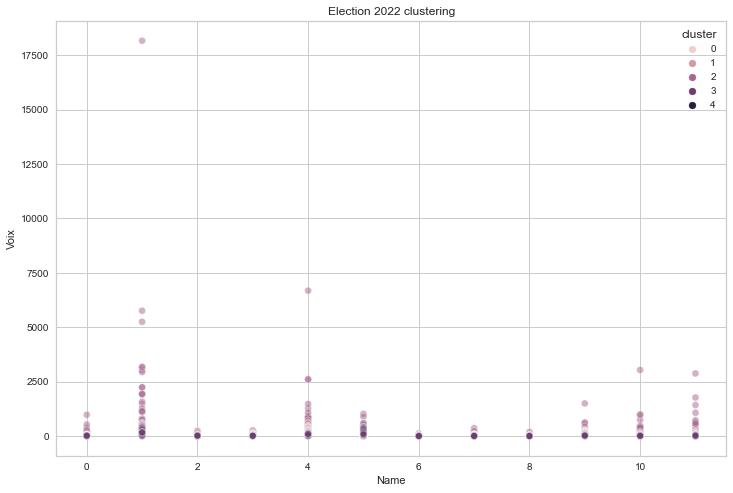

In [12]:
# VISUALISATION


# Seaborn

f,ax = plt.subplots(1,1, figsize=(12,8))
sns.scatterplot(data = X_predict, x='Name', y='Voix', hue='cluster', ax = ax, alpha = 0.5)
ax.set_title('Election 2022 clustering')


In [13]:
from sklearn import metrics

In [14]:
# SCORING

n_clusters = len(X_predict.cluster.unique())
labels = model.labels_

print(f'Estimated number of clusters: {n_clusters:d}')
print(f'Silhouette Score: {metrics.silhouette_score(X, labels, metric="sqeuclidean", random_state=42, sample_size = 10000):0.3f}')
print(f'Calinski-Harabasz Score: {metrics.calinski_harabasz_score(X, labels):.0f}')
print(f'Davies-Bouldin Score: {metrics.davies_bouldin_score(X, labels):0.3f}')

Estimated number of clusters: 5
Silhouette Score: 0.732
Calinski-Harabasz Score: 3944768
Davies-Bouldin Score: 0.520


In [15]:
#Davies-Bouldin Score is defined as a ratio between the cluster scatter and the cluster’s separation 
#and a lower value will mean that the clustering is better.

In [82]:
map_clusters  = folium.Map(
            location=[46.8534, 2.3488],
            zoom_start=6)
markers_colors = []
for lat, lng, cluster in zip(df_map['latitude'], df_map['longitude'], df_map['cluster']):
    folium.vector_layers.CircleMarker(
        [lat, lng],
        radius=5,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.5,
        stroke = False).add_to(map_clusters)
       
map_clusters

In [86]:
data_map.isna().sum()

Code du département    0
Code de la commune     0
Inscrits               0
Abstentions            0
Votants                0
Blancs                 0
Nuls                   0
Exprimés               0
Name                   0
Voix                   0
latitude               0
longitude              0
cluster                0
Candidat               0
dtype: int64

In [55]:
df_map['cluster']

124182    2
604540    2
441450    4
664253    0
385369    4
         ..
143470    4
211292    2
714190    2
252798    3
183888    3
Name: cluster, Length: 20000, dtype: int32

In [58]:
for cl in range(5):
    print(rainbow[cl])


#8000ff
#00b5eb
#80ffb4
#ffb360
#ff0000


In [24]:
mapping_candidate ={'Anne HIDALGO': 0, 'Emmanuel MACRON': 1, 'Fabien ROUSSEL': 2, 'Jean LASSALLE': 3, 'Jean-Luc MÉLENCHON': 4,
 'Marine LE PEN': 5, 'Nathalie ARTHAUD': 6, 'Nicolas DUPONT-AIGNAN': 7, 'Philippe POUTOU': 8, 'Valérie PÉCRESSE': 9,
 'Yannick JADOT': 10, 'Éric ZEMMOUR': 11}

In [25]:
data_name = pd.DataFrame(list(mapping_candidate.items()),columns = ['Candidat','Name'])

In [26]:
data_name 

,Candidat,Name
0,Anne HIDALGO,0
1,Emmanuel MACRON,1
2,Fabien ROUSSEL,2
3,Jean LASSALLE,3
4,Jean-Luc MÉLENCHON,4
5,Marine LE PEN,5
6,Nathalie ARTHAUD,6
7,Nicolas DUPONT-AIGNAN,7
8,Philippe POUTOU,8
9,Valérie PÉCRESSE,9


In [31]:
X_predict.shape

(724008, 13)

In [27]:
data_map =pd.merge(X_predict, data_name , on="Name", how="left")

In [28]:
data_map

,Code du département,Code de la commune,Inscrits,Abstentions,Votants,Blancs,Nuls,Exprimés,Name,Voix,latitude,longitude,cluster,Candidat
0,55.0,55535.0,44,11,33,0,0,33,11,3,49.317453,5.647972,3,Éric ZEMMOUR
1,55.0,55535.0,44,11,33,0,0,33,4,5,49.317453,5.647972,3,Jean-Luc MÉLENCHON
2,55.0,55535.0,44,11,33,0,0,33,9,1,49.317453,5.647972,3,Valérie PÉCRESSE
3,55.0,55545.0,808,329,479,17,3,459,8,8,49.160479,5.378136,3,Philippe POUTOU
4,55.0,55545.0,1318,499,819,14,5,800,2,25,49.150832,5.400586,3,Fabien ROUSSEL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
724003,62.0,62796.0,459,78,381,6,3,372,0,7,50.258141,2.643003,3,Anne HIDALGO
724004,62.0,62801.0,1205,299,906,9,2,895,0,25,50.391562,2.742967,3,Anne HIDALGO
724005,62.0,62803.0,440,75,365,6,4,355,3,13,50.742017,1.919849,3,Jean LASSALLE
724006,62.0,62803.0,440,75,365,6,4,355,7,9,50.742017,1.919849,3,Nicolas DUPONT-AIGNAN


In [62]:
data_map.to_csv(r"C:\Users\rana_\OneDrive\Bureau\Final project\clusters_data.csv") 

In [46]:
df_temp2 = data_map.groupby(['cluster']).agg(TotalInscrits = ('Inscrits', 'sum'), TotalVotes = ('Exprimés', 'sum'))
df_temp2['Participation'] = df_temp2.TotalVotes / df_temp2.TotalInscrits * 100
df_temp2

,TotalInscrits,TotalVotes,Participation
cluster,,,
0,98453892,73493172,74.647300
1,64207152,48514488,75.559321
2,103735104,69406392,66.907334
3,105613704,77216424,73.112126
4,123548736,93923808,76.021666


In [39]:
df_temp = data_map.groupby(['cluster','Candidat']).agg(TotalVotes = ('Exprimés', 'sum'), NbVotes = ('Voix', 'sum'))
df_temp['PctVotes'] = df_temp.NbVotes / df_temp.TotalVotes * 100
df_temp

TotalVotes  NbVotes   PctVotes
cluster Candidat                                             
0       Anne HIDALGO              6124431    97154   1.586335
        Emmanuel MACRON           6124431  1733738  28.308556
        Fabien ROUSSEL            6124431   121919   1.990699
        Jean LASSALLE             6124431   174557   2.850175
        Jean-Luc MÉLENCHON        6124431  1256919  20.523033
        Marine LE PEN             6124431  1476942  24.115579
        Nathalie ARTHAUD          6124431    34522   0.563677
        Nicolas DUPONT-AIGNAN     6124431   145106   2.369298
        Philippe POUTOU           6124431    44501   0.726614
        Valérie PÉCRESSE          6124431   314484   5.134910
        Yannick JADOT             6124431   283150   4.623287
        Éric ZEMMOUR              6124431   441439   7.207837
1       Anne HIDALGO              4042874    75311   1.862808
        Emmanuel MACRON           4042874  1067719  26.409900
        Fabien ROUSSEL            4042874   108576   2.685614
        Jean LASSALLE             4042874   162559   4.020877
        Jean-Luc MÉLENCHON        4042874   778526  19.256747
        Marine LE PEN             4042874  1042771  25.792815
        Nathalie ARTHAUD          4042874    24606   0.608626
        Nicolas DUPONT-AIGNAN     4042874    91164   2.254931
        Philippe POUTOU           4042874    33409   0.826368
        Valérie PÉCRESSE          4042874   197878   4.894488
        Yannick JADOT             4042874   171295   4.236961
        Éric ZEMMOUR              4042874   289060   7.149864
2       Anne HIDALGO              5783866    84542   1.461687
        Emmanuel MACRON           5783866  1575743  27.243767
        Fabien ROUSSEL            5783866   112585   1.946535
        Jean LASSALLE             5783866   122325   2.114935
        Jean-Luc MÉLENCHON        5783866  1659741  28.696049
        Marine LE PEN             5783866  1085438  18.766652
        Nathalie ARTHAUD          5783866    30550   0.528193
        Nicolas DUPONT-AIGNAN     5783866   112810   1.950426
        Philippe POUTOU           5783866    39829   0.688622
        Valérie PÉCRESSE          5783866   292052   5.049425
        Yannick JADOT             5783866   250019   4.322697
        Éric ZEMMOUR              5783866   418232   7.231011
3       Anne HIDALGO              6434702   107961   1.677793
        Emmanuel MACRON           6434702  1785937  27.754774
        Fabien ROUSSEL            6434702   175207   2.722846
        Jean LASSALLE             6434702   226459   3.519339
        Jean-Luc MÉLENCHON        6434702  1200664  18.659201
        Marine LE PEN             6434702  1798506  27.950106
        Nathalie ARTHAUD          6434702    42136   0.654824
        Nicolas DUPONT-AIGNAN     6434702   129280   2.009106
        Philippe POUTOU           6434702    52240   0.811848
        Valérie PÉCRESSE          6434702   268398   4.171102
        Yannick JADOT             6434702   254762   3.959189
        Éric ZEMMOUR              6434702   393152   6.109871
4       Anne HIDALGO              7826984   166182   2.123193
        Emmanuel MACRON           7826984  2191536  27.999751
        Fabien ROUSSEL            7826984   187548   2.396172
        Jean LASSALLE             7826984   284617   3.636356
        Jean-Luc MÉLENCHON        7826984  1693516  21.636891
        Marine LE PEN             7826984  1761990  22.511736
        Nathalie ARTHAUD          7826984    42892   0.548002
        Nicolas DUPONT-AIGNAN     7826984   155442   1.985976
        Philippe POUTOU           7826984    65093   0.831649
        Valérie PÉCRESSE          7826984   350747   4.481254
        Yannick JADOT             7826984   410172   5.240486
        Éric ZEMMOUR              7826984   517249   6.608535

In [40]:
df_temp.drop(['TotalVotes', 'NbVotes'], axis = 1, inplace = True)

In [42]:

df_temp.reset_index(level=[0,1]).pivot(index='Candidat', columns='cluster', values = 'PctVotes')

cluster,0,1,2,3,4
Candidat,,,,,
Anne HIDALGO,1.586335,1.862808,1.461687,1.677793,2.123193
Emmanuel MACRON,28.308556,26.409900,27.243767,27.754774,27.999751
Fabien ROUSSEL,1.990699,2.685614,1.946535,2.722846,2.396172
Jean LASSALLE,2.850175,4.020877,2.114935,3.519339,3.636356
Jean-Luc MÉLENCHON,20.523033,19.256747,28.696049,18.659201,21.636891
Marine LE PEN,24.115579,25.792815,18.766652,27.950106,22.511736
Nathalie ARTHAUD,0.563677,0.608626,0.528193,0.654824,0.548002
Nicolas DUPONT-AIGNAN,2.369298,2.254931,1.950426,2.009106,1.985976
Philippe POUTOU,0.726614,0.826368,0.688622,0.811848,0.831649


In [29]:
data_map.shape

(724008, 14)

In [47]:
#maps for the clusters
nb_points = 20000
df_map= data_map.sample(frac = nb_points/data_map.shape[0], random_state=42)
df_map.cluster.value_counts()
df_map1=df_map.loc[df_map["cluster"]==0]
df_map1

,Code du département,Code de la commune,Inscrits,Abstentions,Votants,Blancs,Nuls,Exprimés,Name,Voix,latitude,longitude,cluster,Candidat
664253,76.0,76414.0,620,143,477,11,3,463,10,8,49.912035,1.121115,0,Yannick JADOT
560510,67.0,67218.0,1057,258,799,6,8,785,0,11,48.524658,7.722443,0,Anne HIDALGO
410170,81.0,81089.0,149,27,122,3,3,116,0,7,44.034775,2.425317,0,Anne HIDALGO
628212,81.0,81004.0,1148,250,898,11,6,881,2,19,43.923371,2.154749,0,Fabien ROUSSEL
51671,80.0,80001.0,1108,382,726,9,9,708,10,22,50.108063,1.828597,0,Yannick JADOT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
198094,79.0,79174.0,351,70,281,3,3,275,8,4,46.179856,-0.163160,0,Philippe POUTOU
363115,77.0,77350.0,1175,289,886,9,12,865,10,43,48.767380,2.673254,0,Yannick JADOT
207263,76.0,76319.0,441,125,316,3,5,308,7,1,49.349811,1.002219,0,Nicolas DUPONT-AIGNAN
131688,81.0,81265.0,67,10,57,0,0,57,10,3,44.111000,1.807000,0,Yannick JADOT


In [48]:
# Initialise map (centered on mean)
map_clusters = folium.Map(location=[data_map.latitude.mean(), data_map.longitude.mean()],
                zoom_start=9, control_scale=False, zoom_control = True, scrollWheelZoom=False, dragging=False)

In [49]:
#colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lng, cluster in zip(df_map1['latitude'], df_map1['longitude'], df_map1['cluster']):
    folium.vector_layers.CircleMarker(
        [lat, lng],
        radius=5,
        #color=rainbow[cluster-1],
        fill=True,
        #fill_color=rainbow[cluster-1],
        fill_opacity=0.9,
        stroke = False).add_to(map_clusters)
    

      
map_clusters

In [50]:
#2 map
nb_points = 20000
df_map= data_map.sample(frac = nb_points/data_map.shape[0], random_state=42)
df_map.cluster.value_counts()
df_map1=df_map.loc[df_map["cluster"]==1]
df_map1

,Code du département,Code de la commune,Inscrits,Abstentions,Votants,Blancs,Nuls,Exprimés,Name,Voix,latitude,longitude,cluster,Candidat
88775,21.0,21149.0,117,23,94,4,1,89,1,21,47.943973,4.513419,1,Emmanuel MACRON
235202,14.0,14496.0,46,10,36,0,0,36,4,9,48.921693,-0.604592,1,Jean-Luc MÉLENCHON
583423,14.0,14528.0,304,66,238,1,2,235,3,12,49.337050,0.307838,1,Jean LASSALLE
288627,15.0,15028.0,310,69,241,4,1,236,3,20,44.882805,2.578822,1,Jean LASSALLE
262961,22.0,22278.0,895,190,705,5,7,693,7,8,48.520445,-2.726482,1,Nicolas DUPONT-AIGNAN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
539669,24.0,24016.0,649,116,533,9,6,518,2,18,45.594106,0.702436,1,Fabien ROUSSEL
499085,11.0,11374.0,32,12,20,3,0,17,1,5,42.959990,2.605701,1,Emmanuel MACRON
115999,12.0,12210.0,359,57,302,2,3,297,2,13,44.190458,2.040046,1,Fabien ROUSSEL
106895,13.0,13028.0,1082,311,771,19,4,748,10,29,43.189220,5.625217,1,Yannick JADOT


In [51]:
# Initialise map (centered on mean)
map_clusters = folium.Map(location=[data_map.latitude.mean(), data_map.longitude.mean()],
                zoom_start=9, control_scale=False, zoom_control = True, scrollWheelZoom=False, dragging=False)

In [52]:
#colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lng, cluster in zip(df_map1['latitude'], df_map1['longitude'], df_map1['cluster']):
    folium.vector_layers.CircleMarker(
        [lat, lng],
        radius=5,
        #color=rainbow[cluster-1],
        fill=True,
        #fill_color=rainbow[cluster-1],
        fill_opacity=0.9,
        stroke = False).add_to(map_clusters)
    

      
map_clusters

In [ ]:
#This model is the best model for our analysis beacause there is no overlapping between clusters